In [13]:
# to ignore the warnings 
import warnings
warnings.filterwarnings("ignore")

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [15]:
df = pd.read_csv('po1_data.csv')
df.head()

,id,jitter_p,jitter_abs_us,jitter_rap,jitter_ppq5,jitter_ddp,shimmer_p,shimmer_dB,shimmer_apq3,shimmer_apd5,...,pitch_max,pulse_num,pulse_period,pulse_mean_period,pulse_std_period,voice_frac,voice_num_break,voice_deg_break,UPDRS,pd_class
0,1,1.488,0.000090,0.900,0.794,2.699,8.334,0.779,4.517,4.609,...,187.576,160,159,0.006065,0.000416,0.000,0,0.000,23,1
1,1,0.728,0.000038,0.353,0.376,1.059,5.864,0.642,2.058,3.180,...,234.505,170,169,0.005181,0.000403,2.247,0,0.000,23,1
2,1,1.220,0.000074,0.732,0.670,2.196,8.719,0.875,4.347,5.166,...,211.442,1431,1427,0.006071,0.000474,10.656,1,0.178,23,1
3,1,2.502,0.000123,1.156,1.634,3.469,13.513,1.273,5.263,8.771,...,220.230,94,92,0.004910,0.000320,0.000,0,0.000,23,1
4,1,3.509,0.000167,1.715,1.539,5.145,9.112,1.040,3.102,4.927,...,225.162,117,114,0.004757,0.000380,18.182,1,13.318,23,1


In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1040 entries, 0 to 1039
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   1040 non-null   int64  
 1   jitter_p             1040 non-null   float64
 2   jitter_abs_us        1040 non-null   float64
 3   jitter_rap           1040 non-null   float64
 4   jitter_ppq5          1040 non-null   float64
 5   jitter_ddp           1040 non-null   float64
 6   shimmer_p            1040 non-null   float64
 7   shimmer_dB           1040 non-null   float64
 8   shimmer_apq3         1040 non-null   float64
 9   shimmer_apd5         1040 non-null   float64
 10  shimmer_apq11        1040 non-null   float64
 11  shimmer_dda          1040 non-null   float64
 12  harmonicity_NHR_HNR  1040 non-null   float64
 13  harmonicity_NHR      1040 non-null   float64
 14  harmonicity_HNR      1040 non-null   float64
 15  pitch_median         1040 non-null   f

In [17]:
for column in df.columns:
    unique_values = df[column].unique()
    print(f"Unique values in '{column}':")
    print(unique_values)
    print("\n")


Unique values in 'id':
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40]


Unique values in 'jitter_p':
[ 1.488   0.728   1.22    2.502   3.509   2.47    1.583   1.92    2.257
  1.594   2.286   1.728   2.105   3.343   2.025   2.517   3.29    5.534
  1.137   2.162   1.533   2.783   3.999   2.227   2.638   0.427   0.844
  1.264   2.877   4.052   2.7     2.619   3.457   2.664   3.531   4.162
  3.34    3.671   3.314   2.026   3.09    4.51    4.48    1.207   3.094
  3.017   1.424   2.569   1.037   2.716   1.797   1.493   1.497   1.542
  2.848   2.367   1.651   1.352   1.68    1.922   3.706   2.199   1.909
  2.757   2.624   3.197   2.75    9.52    2.627   3.508   3.432   5.906
  4.661   3.405   1.871   5.581   0.607   0.287   0.585   1.903   1.763
  0.911   0.715   1.297   1.068   1.295   1.176   1.863   0.767   1.811
  2.702   2.904   2.952   1.353   1.64    1.344   1.697   1.054   1.12
  1.992   2.022   0.695   0.395 

In [18]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
id,1040.0,20.500000,11.548950,1.000000,10.750000,20.500000,30.250000,40.000000
jitter_p,1040.0,2.679523,1.765053,0.190000,1.507500,2.396000,3.411500,14.376000
jitter_abs_us,1040.0,0.000170,0.000106,0.000006,0.000095,0.000151,0.000229,0.000777
jitter_rap,1040.0,1.247053,0.979462,0.062000,0.617000,1.035500,1.602500,8.016000
jitter_ppq5,1040.0,1.348327,1.138742,0.081000,0.665750,1.126500,1.694750,13.542000
jitter_ddp,1040.0,3.741161,2.938443,0.185000,1.851750,3.107000,4.808500,24.048000
shimmer_p,1040.0,12.918391,5.452204,1.185000,9.353500,12.348500,15.493250,41.137000
shimmer_dB,1040.0,1.194895,0.420071,0.103000,0.941000,1.181500,1.411000,2.721000
shimmer_apq3,1040.0,5.699600,3.015183,0.496000,3.703000,5.134500,6.942000,25.820000
shimmer_apd5,1040.0,7.983552,4.840892,0.708000,5.160250,7.050500,9.558930,72.860000


1. Bivariate Analysis using Seaborn Pairplot
2. p-value calculate
3. t-test
4. cohen's d value
5. correlation matrix analysis
6. univariate analysis between some significant feature and less significant feature
7. multivariate analysis by model training
8. dimensionality reduction using PCA and compare with our analysis

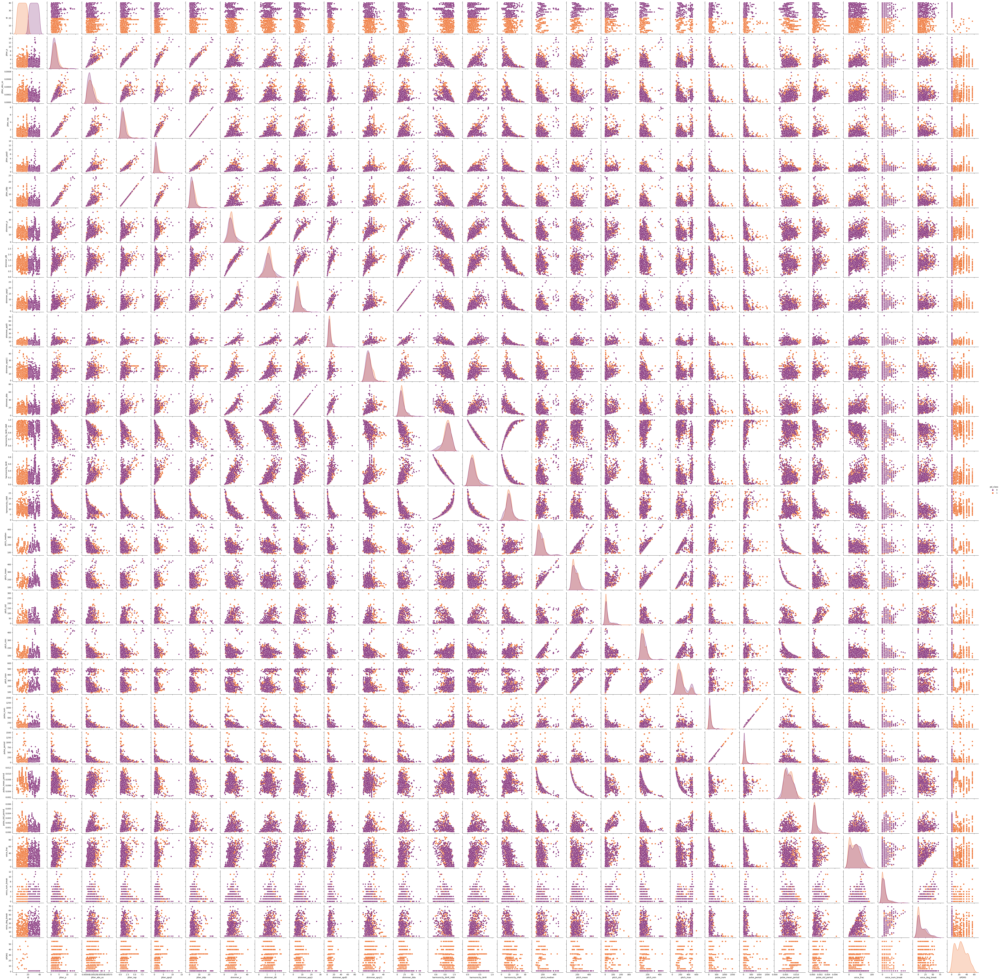

In [5]:
# Bivariate Analysis
sns.pairplot(df , hue="pd_class", markers=["o", "s", "D"] , palette = 'inferno')

In [19]:
# Perform statistical tests to identify significant differences
from scipy.stats import ttest_ind

# separate dataframes for PD and Healthy groups
df['pd_class'] = df['pd_class'].replace({0: 'Healthy', 1: 'PD'})
pd_data = df[df['pd_class'] == 'PD']
healthy_data = df[df['pd_class'] == 'Healthy']

statistical_tests = pd.DataFrame(columns=['Feature', 't-statistic', 'p-value'])
cols_to_visualize = df.columns[1:28]

# perform t-tests for each feature
for col in cols_to_visualize:
    t_stat, p_value = ttest_ind(pd_data[col], healthy_data[col])
    statistical_tests = statistical_tests.append({'Feature': col, 't-statistic': t_stat, 'p-value': p_value},
                                                 ignore_index=True)

statistical_tests.sort_values(by='p-value', ascending=True, inplace=True)

significant_features = statistical_tests[statistical_tests['p-value'] < 0.05]
print("\nFeatures with significant differences between PD and Healthy groups:")
print(significant_features)


Features with significant differences between PD and Healthy groups:
                Feature  t-statistic        p-value
26                UPDRS    37.133448  1.025914e-192
1         jitter_abs_us     5.457006   6.055253e-08
9         shimmer_apq11     4.765622   2.150732e-06
18            pitch_max    -4.535416   6.418899e-06
25      voice_deg_break    -4.097061   4.510173e-05
23           voice_frac    -3.961621   7.952773e-05
16            pitch_std    -3.929679   9.068988e-05
2            jitter_rap     3.603150   3.292913e-04
4            jitter_ddp     3.602961   3.295282e-04
3           jitter_ppq5     3.596282   3.379936e-04
15           pitch_mean    -3.345050   8.521219e-04
0              jitter_p     3.157992   1.634450e-03
14         pitch_median    -2.723141   6.574901e-03
21    pulse_mean_period     2.643079   8.339339e-03
11  harmonicity_NHR_HNR     2.621338   8.886608e-03
24      voice_num_break    -2.580229   1.000993e-02
12      harmonicity_NHR    -2.458168   1.41272

In [20]:
# Cohen's d for each significant feature

cohen_d = {}
for feature in cols_to_visualize:
    pd_values = pd_data[feature]
    healthy_values = healthy_data[feature]
    mean_diff = np.mean(pd_values) - np.mean(healthy_values)
    pooled_std = np.sqrt((np.std(pd_values, ddof=1) ** 2 + np.std(healthy_values, ddof=1) ** 2) / 2)
    cohen_d[feature] = abs(mean_diff / pooled_std)

sorted_cohen_d = sorted(cohen_d.items(), key=lambda x: x[1], reverse=True)

print("\nCohen's d values for significant features (sorted):")
for feature, d in sorted_cohen_d:
    print(f"{feature}: {d:.2f}")


Cohen's d values for significant features (sorted):
UPDRS: 2.30
jitter_abs_us: 0.34
shimmer_apq11: 0.30
pitch_max: 0.28
voice_deg_break: 0.25
voice_frac: 0.25
pitch_std: 0.24
jitter_rap: 0.22
jitter_ddp: 0.22
jitter_ppq5: 0.22
pitch_mean: 0.21
jitter_p: 0.20
pitch_median: 0.17
pulse_mean_period: 0.16
harmonicity_NHR_HNR: 0.16
voice_num_break: 0.16
harmonicity_NHR: 0.15
pitch_min: 0.12
pulse_std_period: 0.12
pulse_period: 0.09
pulse_num: 0.08
harmonicity_HNR: 0.08
shimmer_dB: 0.05
shimmer_apd5: 0.05
shimmer_dda: 0.04
shimmer_apq3: 0.04
shimmer_p: 0.02


<Axes: >

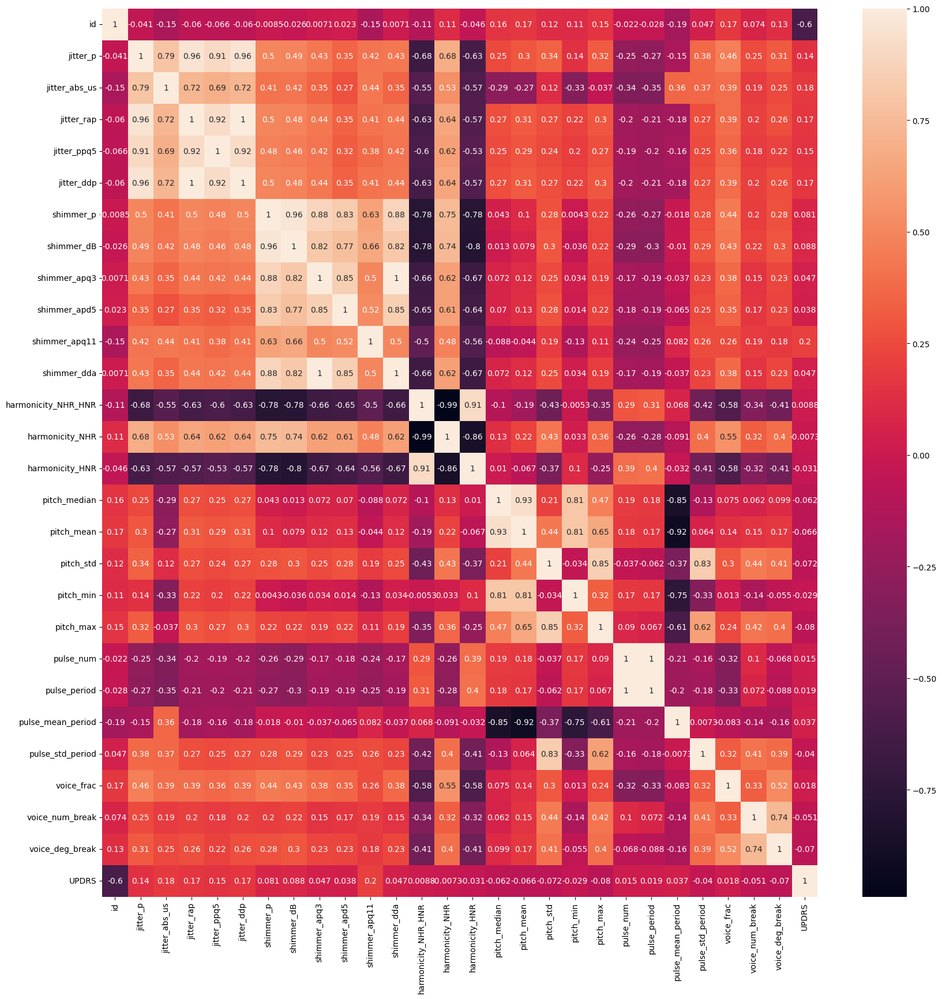

In [21]:
# Finding Correlation
plt.figure(figsize=(20,20))
corr = df.corr()
sns.heatmap(corr, annot = True)

<Axes: >

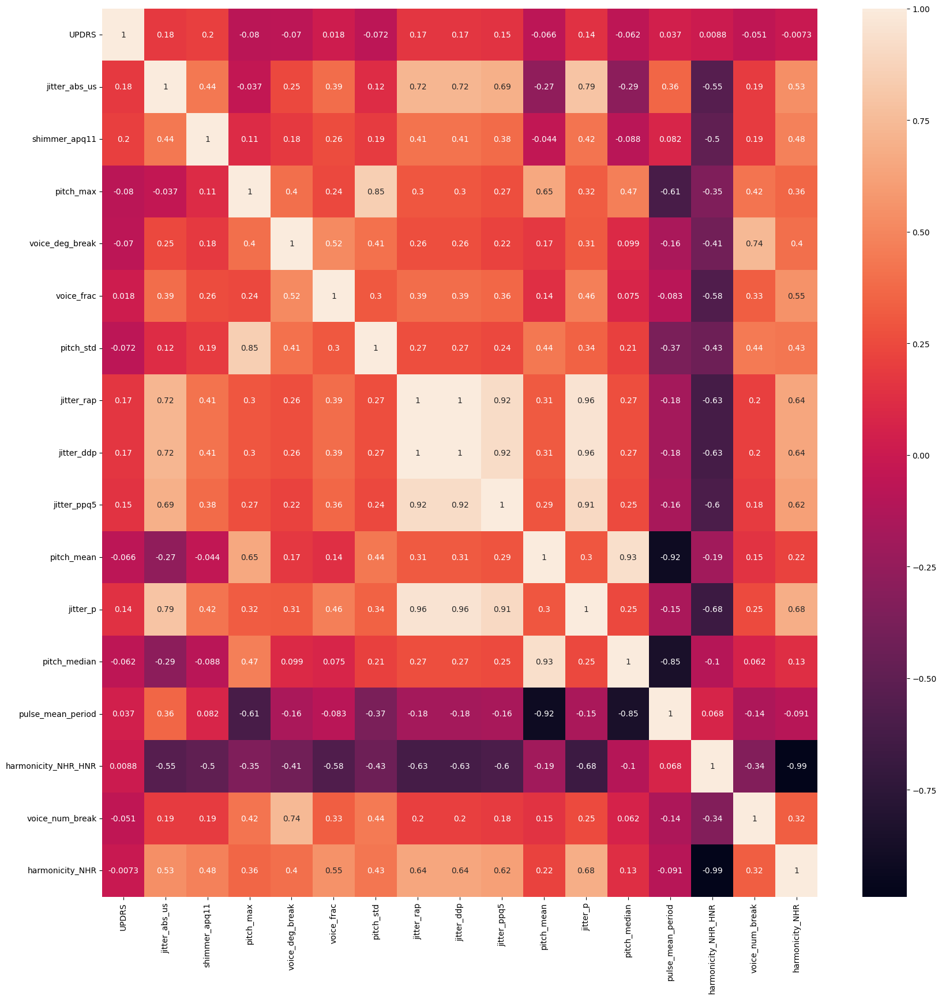

In [76]:
# Finding Correlation
plt.figure(figsize=(20,20))
corr = df[significant_features['Feature']].corr()
sns.heatmap(corr, annot = True)

In [22]:
# with the following function we can select highly correlated features
# it will remove the first feature that is correlated with anything other feature

def correlation(dataset, threshold):
    col_corr = set()  
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold: # we are interested in absolute coeff value
                colname = corr_matrix.columns[i]  # getting the name of column
                col_corr.add(colname)
    return col_corr

corr_features = correlation(df[significant_features['Feature']].drop(['jitter_ddp', 'jitter_ppq5', 'jitter_p'],axis=1), 0.9)
len(set(corr_features))

3

<Axes: >

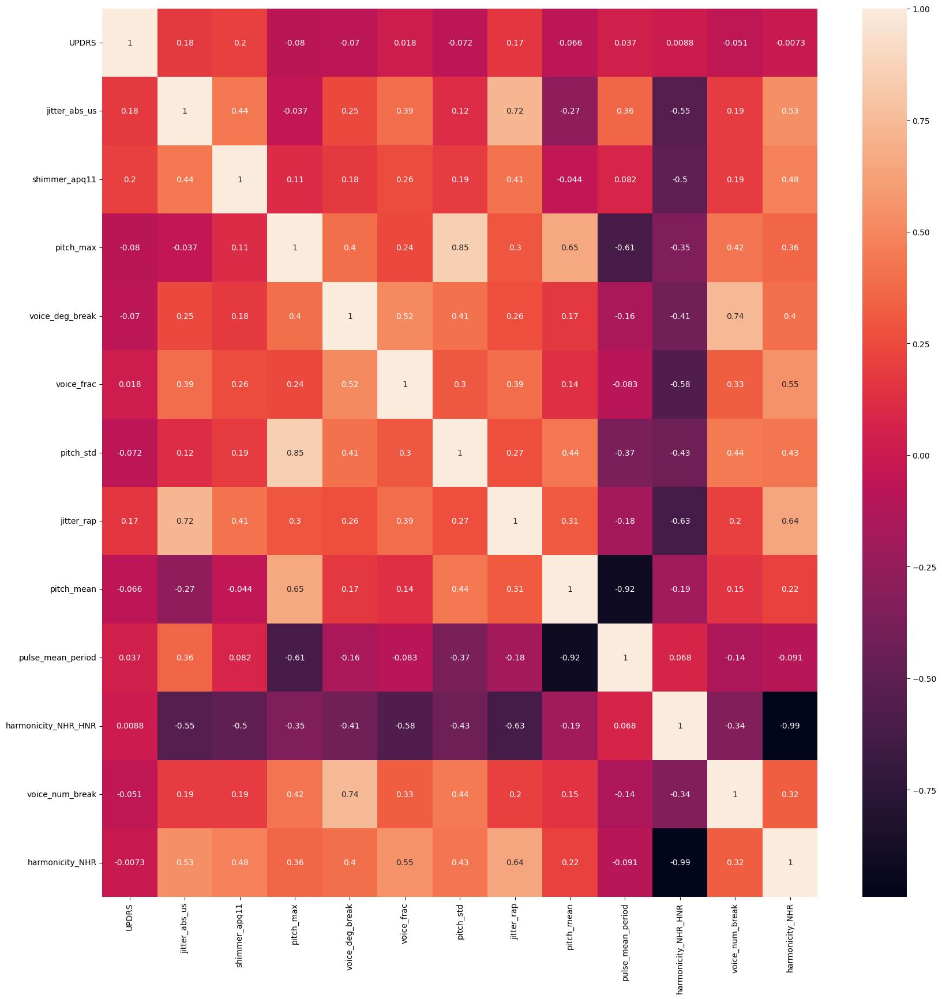

In [23]:
# Finding Correlation
plt.figure(figsize=(20,20))
corr = df[significant_features['Feature']].drop(['jitter_ddp', 'jitter_ppq5', 'jitter_p', 'pitch_median'],axis=1).corr()
sns.heatmap(corr, annot = True)

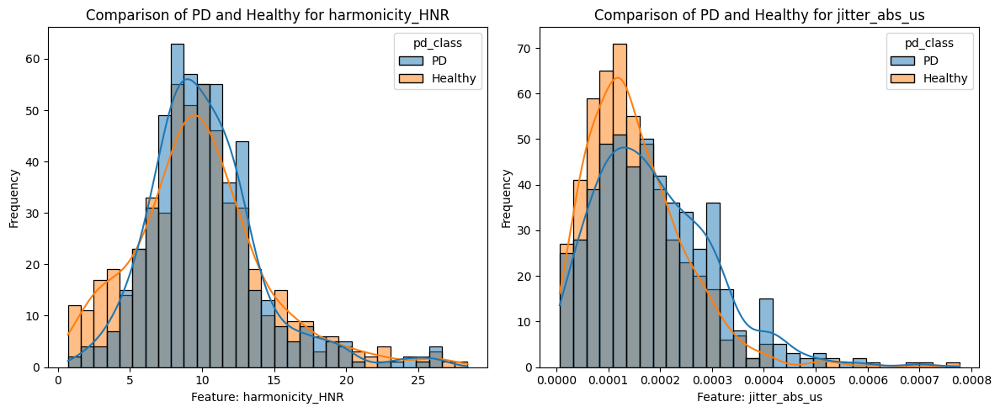

In [24]:
# Create subplots grid for each feature
fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Adjust the number of columns as needed

# Assuming you have a DataFrame 'df' with your data

# Feature 1: harmonicity_HNR
sns.histplot(data=df, x="harmonicity_HNR", hue="pd_class", kde=True, ax=axes[0])
axes[0].set_xlabel("Feature: harmonicity_HNR")
axes[0].set_ylabel("Frequency")
axes[0].set_title("Comparison of PD and Healthy for harmonicity_HNR")

# Feature 2: jitter_abs_us
sns.histplot(data=df, x="jitter_abs_us", hue="pd_class", kde=True, ax=axes[1])
axes[1].set_xlabel("Feature: jitter_abs_us")
axes[1].set_ylabel("Frequency")
axes[1].set_title("Comparison of PD and Healthy for jitter_abs_us")

# Adjust layout
plt.tight_layout()

# Show the subplots
plt.show()

In [28]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score


# Split the data into training and testing sets

# X = df.drop(['id', 'UPDRS', 'pd_class'], axis=1)
# X = df[significant_features['Feature']].drop(['UPDRS'], axis=1)
X = df[significant_features['Feature']].drop(['UPDRS','jitter_ddp', 'jitter_ppq5', 'jitter_p', 'pitch_median'], axis=1)

y = df['pd_class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=100)

# Train a Random Forest classifier
clf = RandomForestClassifier(random_state=42)
clf.fit(X_train, y_train)

# Predict on the test set
y_pred = clf.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy:.2f}")
print("Classification Report:")
print(classification_rep)


Accuracy: 0.67
Classification Report:
              precision    recall  f1-score   support

     Healthy       0.64      0.71      0.67       150
          PD       0.70      0.63      0.66       162

    accuracy                           0.67       312
   macro avg       0.67      0.67      0.67       312
weighted avg       0.67      0.67      0.67       312



In [29]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA

df_new = pd.read_csv('po1_data.csv')

# Create a MinMaxScaler
scaler = MinMaxScaler(feature_range=(-1, 1))

X = df_new.drop(['id', 'UPDRS', 'pd_class'], axis=1)
y = df_new['pd_class']

df_scaled = scaler.fit_transform(X)

In [30]:
pca=PCA(n_components=12)
pca.fit(df_scaled)

x_pca=pca.transform(df_scaled)

In [31]:
X_train, X_test, y_train, y_test = train_test_split(x_pca, y, test_size=0.3, random_state=100)

# Train a Random Forest classifier
clf = RandomForestClassifier(random_state=42)
clf.fit(X_train, y_train)

# Predict on the test set
y_pred = clf.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

print(f"Accuracy: {accuracy:.2f}")
print("Classification Report:")
print(classification_rep)

Accuracy: 0.67
Classification Report:
              precision    recall  f1-score   support

           0       0.64      0.70      0.67       150
           1       0.70      0.64      0.66       162

    accuracy                           0.67       312
   macro avg       0.67      0.67      0.67       312
weighted avg       0.67      0.67      0.67       312

